In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.io
import matplotlib.pyplot as plt
import os
import anndata
import seaborn as sns
import harmonypy as hm

%matplotlib inline
import scFates as scf

/bin/sh: which: line 1: syntax error: unexpected end of file
/bin/sh: error importing function definition for `which'
/bin/sh: module: line 1: syntax error: unexpected end of file
/bin/sh: error importing function definition for `module'
/bin/sh: scl: line 1: syntax error: unexpected end of file
/bin/sh: error importing function definition for `scl'
/bin/sh: ml: line 1: syntax error: unexpected end of file
/bin/sh: error importing function definition for `ml'
sh: which: line 1: syntax error: unexpected end of file
sh: error importing function definition for `which'
sh: module: line 1: syntax error: unexpected end of file
sh: error importing function definition for `module'
sh: scl: line 1: syntax error: unexpected end of file
sh: error importing function definition for `scl'
sh: ml: line 1: syntax error: unexpected end of file
sh: error importing function definition for `ml'
sh: which: line 1: syntax error: unexpected end of file
sh: error importing function definition for `which'
sh: 

In [2]:
sc.settings.set_figure_params(dpi=200,fontsize=15)

In [3]:
adata_orig = sc.read_h5ad('/rds/general/user/snb20/projects/cardiac_single_cell_biology/live/Endothelial_datasets/data_analyzed/sanger_datasets/adult18_vas_20230622_SNB.h5ad')

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [4]:
adata = adata_orig

In [5]:
adata

AnnData object with n_obs × n_vars = 74555 × 31402
    obs: 'id', 'organ', 'donor', 'kit', 'sorting', 'location', 'age', 'gender', 'dissociation', 'scrublet_score', 'doublet_bh_pval', 'published_annotation', 'HCA', 'batch', 'study', 'sample', 'cell_ontology_class', 'free_annotation', 'compartment', 'age2', 'barcode', 'concat_sample_no', 'Population ', 'hospital_id', 'Organ', 'doublet_pval', 'Project', 'broad_celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'int_or_ext', 'leiden_scVI', 'organ_uni', 'uni_index', 'subsample', 'donor_organ', 'donor_location', 'numbering', 'ann_ec_2', 'scoring_cc_s', 'scoring_cc_m', 'scoring_cc', 'score_s_genes', 'score_g2m_genes', 'score_angio_genes', 'score_EMT_genes', 'score_MET_genes', 'score_stress_genes', 'ann_ec_av', 'ann_ec_size', 'ann_ec_cap', 'ann_ec_final', 'test', 'ann_vas_1', 'published_annotation_skin', 'int_ext', 'Cell_category', 'Predicted_labels_CellTypist', 'Majority_vo

In [14]:
adata_art = adata[adata.obs["ann_merged_final"].isin(["large_art_ec","art_ec_1","art_ec_2","cap_ec"])].copy()

In [15]:
sc.pp.normalize_total(adata_art, target_sum=1e4)

sc.pp.log1p(adata_art)

In [16]:
sc.pp.highly_variable_genes(adata_art)
adata_hvg = adata_art[:, adata_art.var['highly_variable']].copy()

In [17]:
sc.tl.pca(adata_hvg, svd_solver = 'arpack', use_highly_variable = True, random_state = 9, n_comps=100)

In [18]:
adata_art

AnnData object with n_obs × n_vars = 9029 × 31402
    obs: 'id', 'organ', 'donor', 'kit', 'sorting', 'location', 'age', 'gender', 'dissociation', 'scrublet_score', 'doublet_bh_pval', 'published_annotation', 'HCA', 'batch', 'study', 'sample', 'cell_ontology_class', 'free_annotation', 'compartment', 'age2', 'barcode', 'concat_sample_no', 'Population ', 'hospital_id', 'Organ', 'doublet_pval', 'Project', 'broad_celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'int_or_ext', 'leiden_scVI', 'organ_uni', 'uni_index', 'subsample', 'donor_organ', 'donor_location', 'numbering', 'ann_ec_2', 'scoring_cc_s', 'scoring_cc_m', 'scoring_cc', 'score_s_genes', 'score_g2m_genes', 'score_angio_genes', 'score_EMT_genes', 'score_MET_genes', 'score_stress_genes', 'ann_ec_av', 'ann_ec_size', 'ann_ec_cap', 'ann_ec_final', 'test', 'ann_vas_1', 'published_annotation_skin', 'int_ext', 'Cell_category', 'Predicted_labels_CellTypist', 'Majority_vot

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


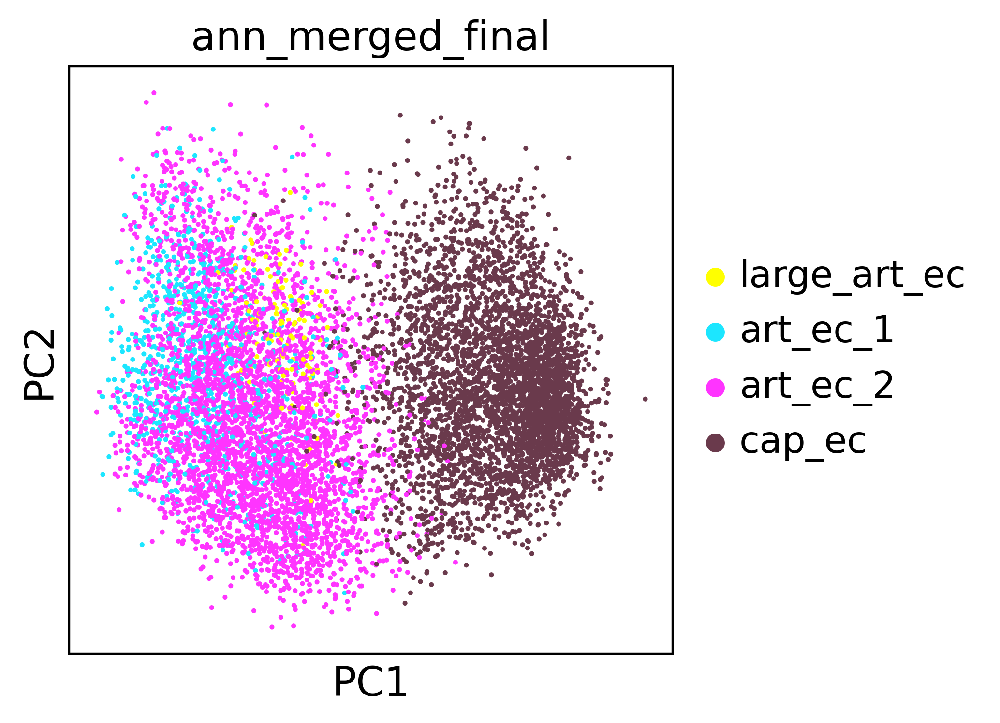

In [20]:
sc.pl.pca(adata_hvg, color = 'ann_merged_final')

In [21]:
pca = adata_hvg.obsm['X_pca']
batch = adata_hvg.obs['donor']
meta_data = adata_hvg.obs

ho = hm.run_harmony(pca, meta_data, ['donor'], epsilon_harmony = -float('Inf'), max_iter_harmony = 20, max_iter_kmeans = 20, tau=5)

res = pd.DataFrame(ho.Z_corr)
res=res.T
adata_hvg.obsm['X_pca'] = res.values

2024-01-07 13:45:32,614 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-01-07 13:45:35,760 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-07 13:45:35,809 - harmonypy - INFO - Iteration 1 of 20
2024-01-07 13:45:39,195 - harmonypy - INFO - Iteration 2 of 20
2024-01-07 13:45:42,728 - harmonypy - INFO - Iteration 3 of 20
2024-01-07 13:45:46,334 - harmonypy - INFO - Iteration 4 of 20
2024-01-07 13:45:49,842 - harmonypy - INFO - Iteration 5 of 20
2024-01-07 13:45:52,554 - harmonypy - INFO - Iteration 6 of 20
2024-01-07 13:45:55,257 - harmonypy - INFO - Iteration 7 of 20
2024-01-07 13:45:57,623 - harmonypy - INFO - Iteration 8 of 20
2024-01-07 13:45:59,790 - harmonypy - INFO - Iteration 9 of 20
2024-01-07 13:46:01,958 - harmonypy - INFO - Iteration 10 of 20
2024-01-07 13:46:04,031 - harmonypy - INFO - Iteration 11 of 20
2024-01-07 13:46:06,075 - harmonypy - INFO - Iteration 12 of 20
2024-01-07 13:46:08,049 - harmonypy - INFO - Iteration 13 of

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


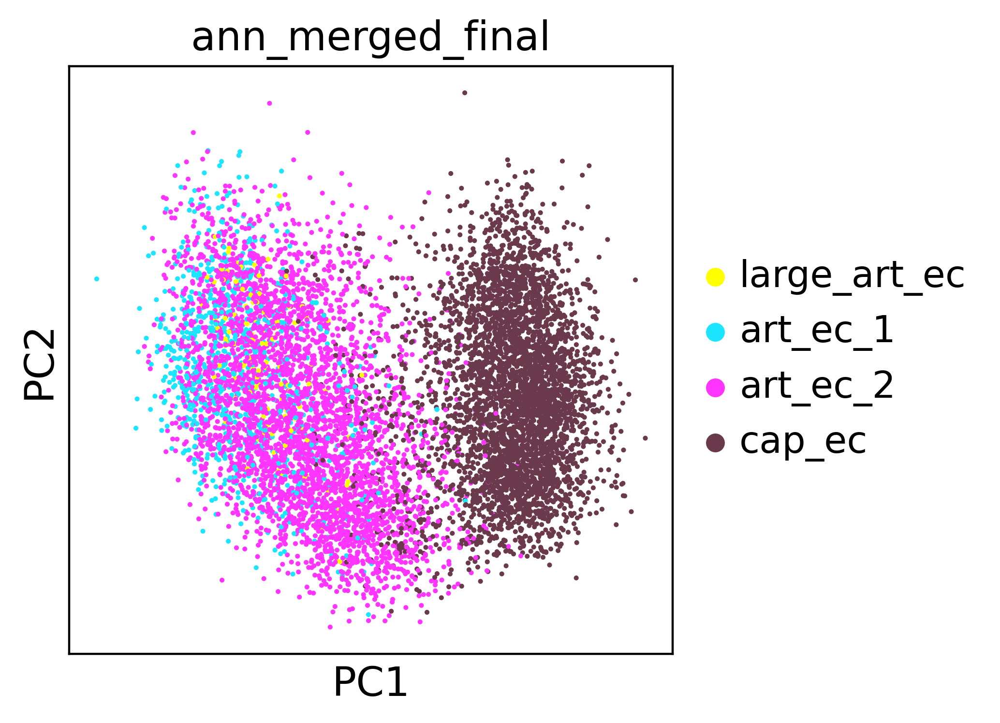

In [22]:
sc.pl.pca(adata_hvg, color = 'ann_merged_final')

In [23]:
sc.pp.neighbors(adata_hvg, random_state = 1, use_rep = 'X_pca', n_neighbors = 30)

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/rds/general/user/snb20/home/anaconda3

In [24]:
#sc.tl.umap(adata_hvg, spread = 1, random_state = 1, min_dist = 1.5)
sc.tl.umap(adata_hvg, random_state = 1, spread = 0.6, min_dist = 1)

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


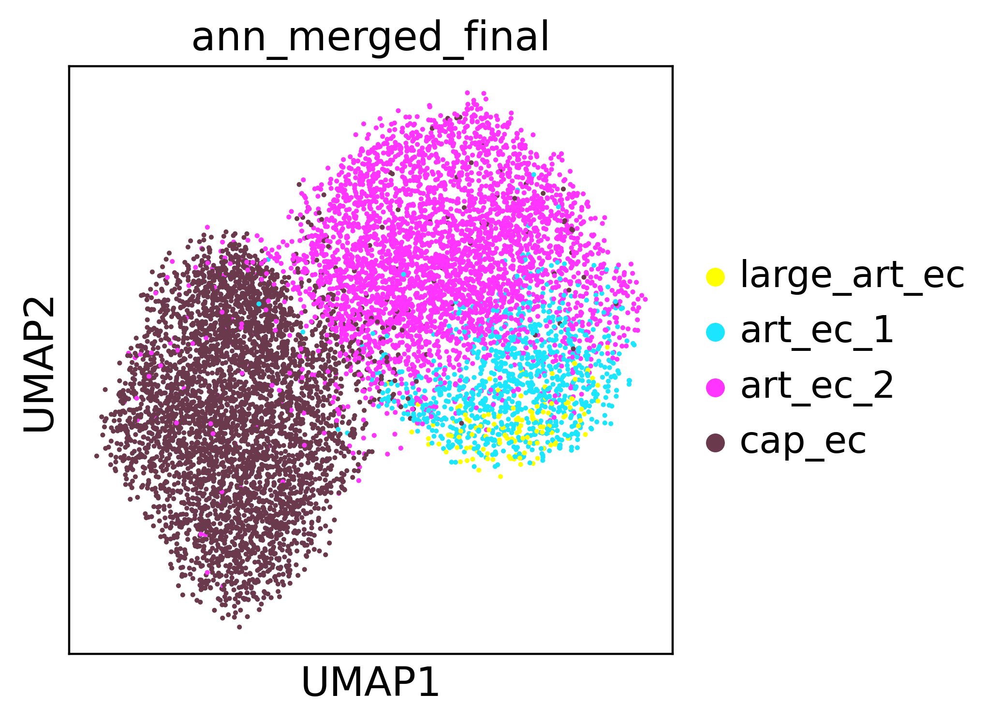

In [25]:
sc.pl.umap(adata_hvg, color = 'ann_merged_final')

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


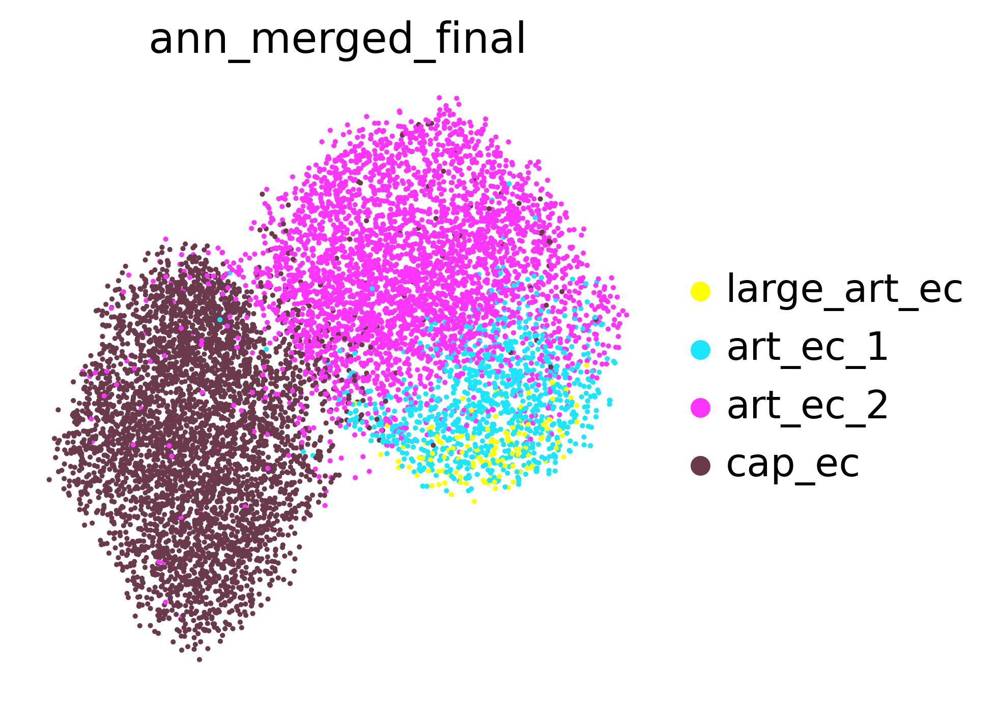

In [26]:
sc.pl.umap(adata_hvg, color = 'ann_merged_final', frameon = False)

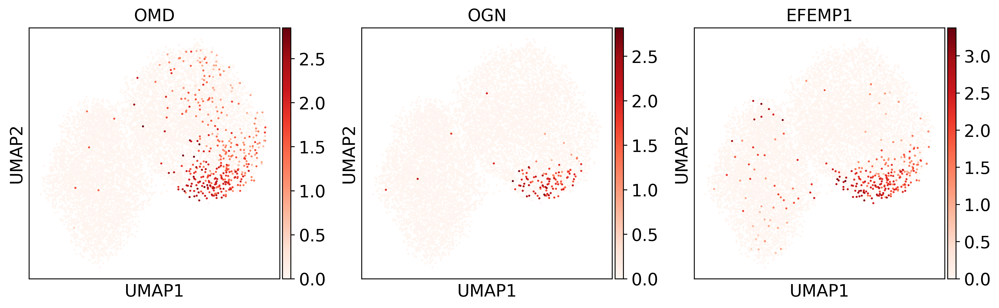

In [27]:
sc.pl.umap(adata_hvg, color = ['OMD','OGN','EFEMP1'], cmap = 'Reds')

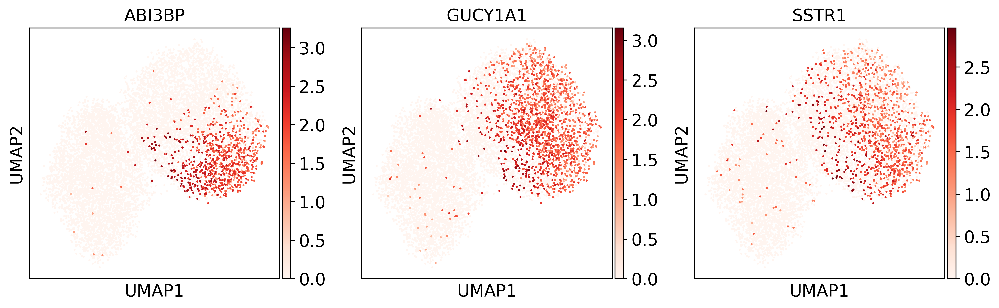

In [28]:
sc.pl.umap(adata_hvg, color = ["ABI3BP","GUCY1A1","SSTR1"], cmap = 'Reds')

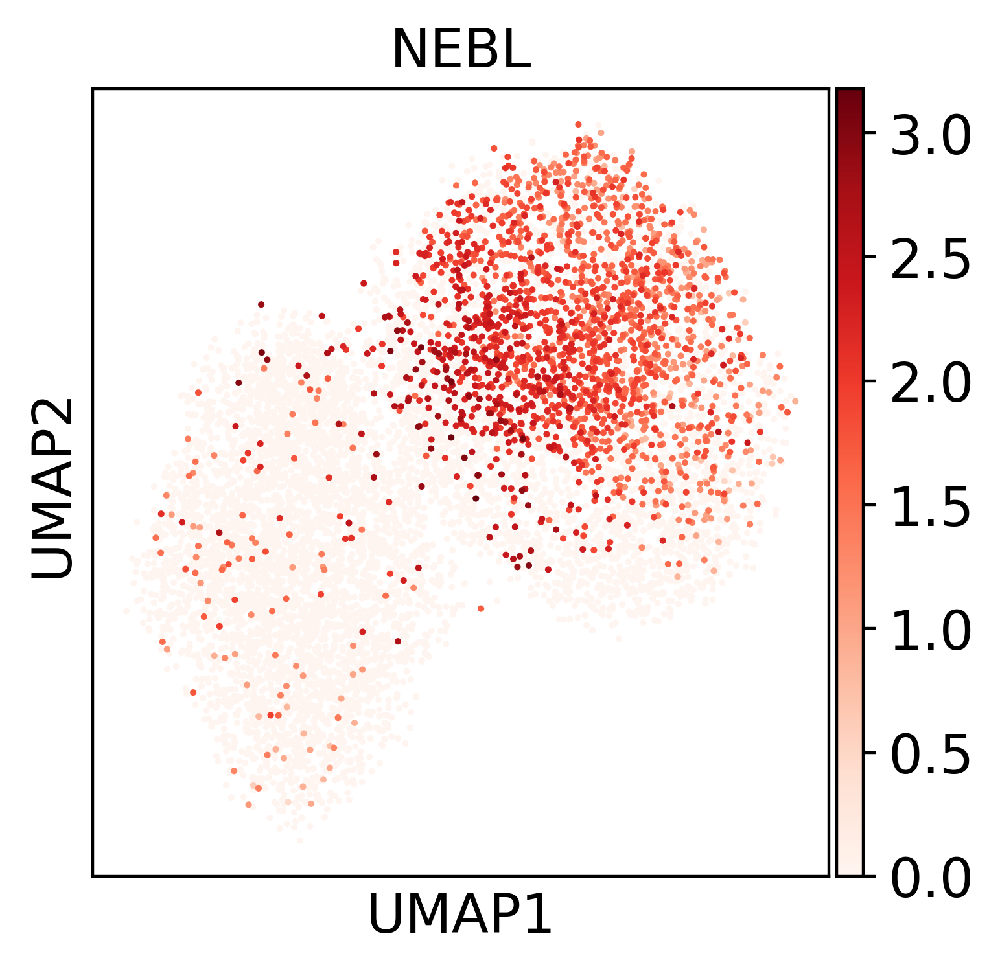

In [29]:
sc.pl.umap(adata_hvg, color = "NEBL", cmap = 'Reds')

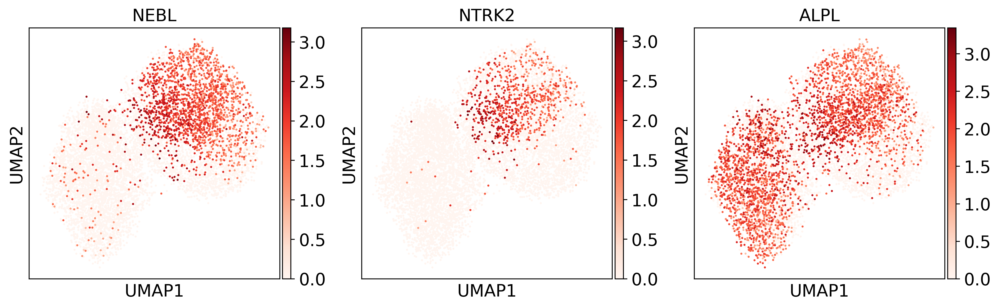

In [30]:
sc.pl.umap(adata_hvg, color = ["NEBL","NTRK2","ALPL"], cmap = 'Reds')

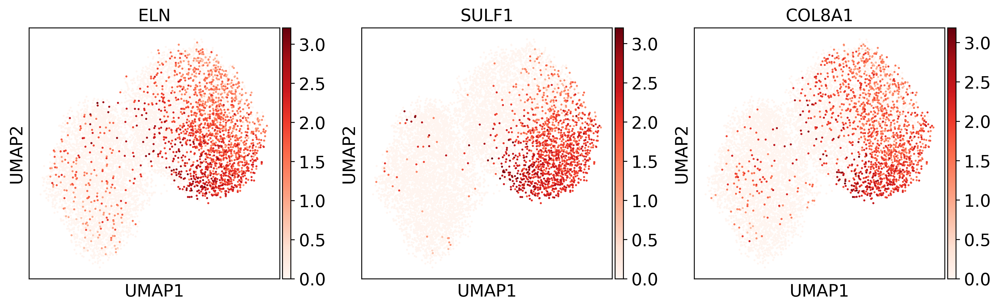

In [31]:
sc.pl.umap(adata_hvg, color = ['ELN','SULF1','COL8A1'], cmap = 'Reds')

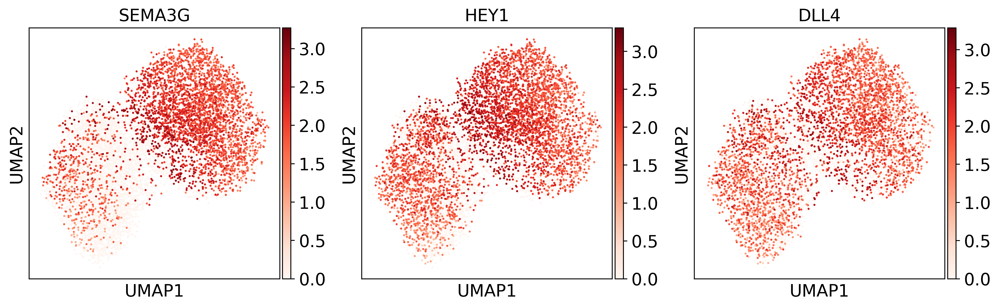

In [32]:
sc.pl.umap(adata_hvg, color = ["SEMA3G","HEY1","DLL4"], cmap = 'Reds')

In [33]:
scf.tl.curve(adata_hvg,Nodes=5,use_rep="X_umap",ndims_rep=100)

inferring a principal curve --> parameters used 
    5 principal points, mu = 0.1, lambda = 0.01
    finished (0:00:01) --> added 
    .uns['epg'] dictionnary containing inferred elastic curve generated from elpigraph.
    .obsm['X_R'] hard assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'], coordinates of principal points in representation space.


/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


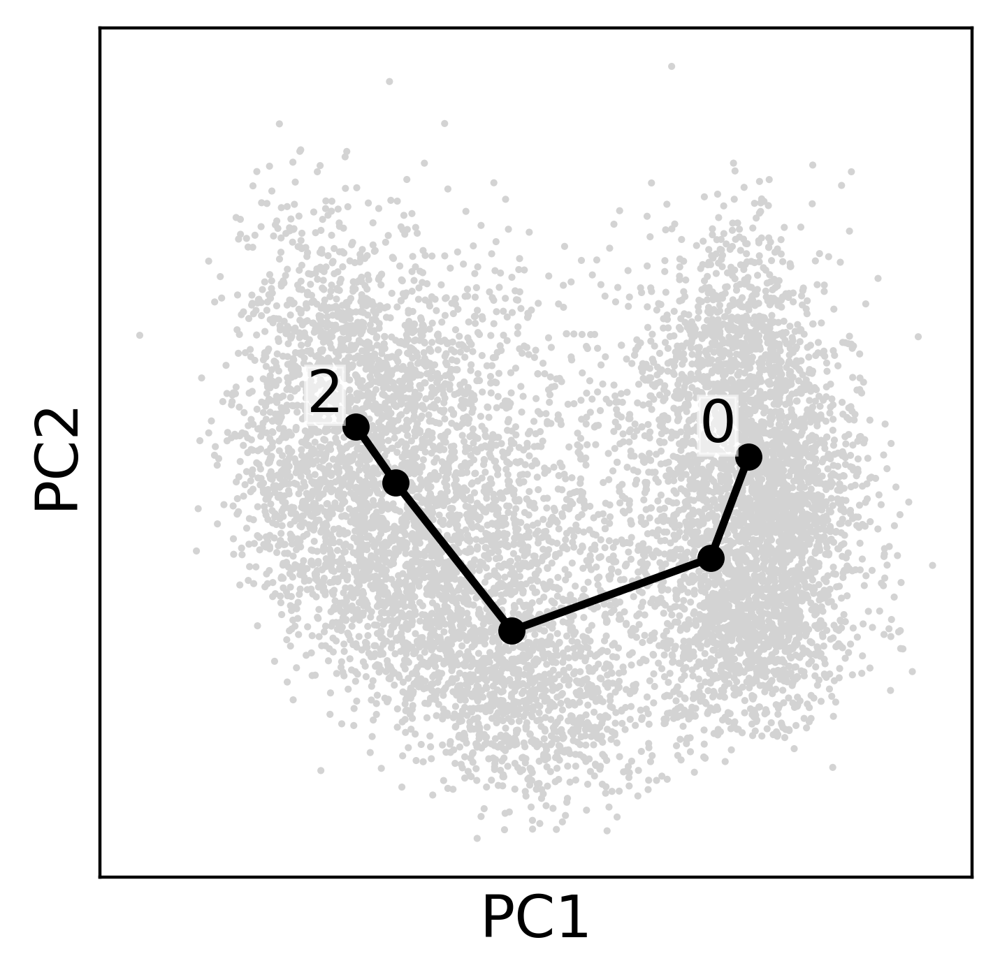

In [34]:
scf.pl.graph(adata_hvg,basis="pca")

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


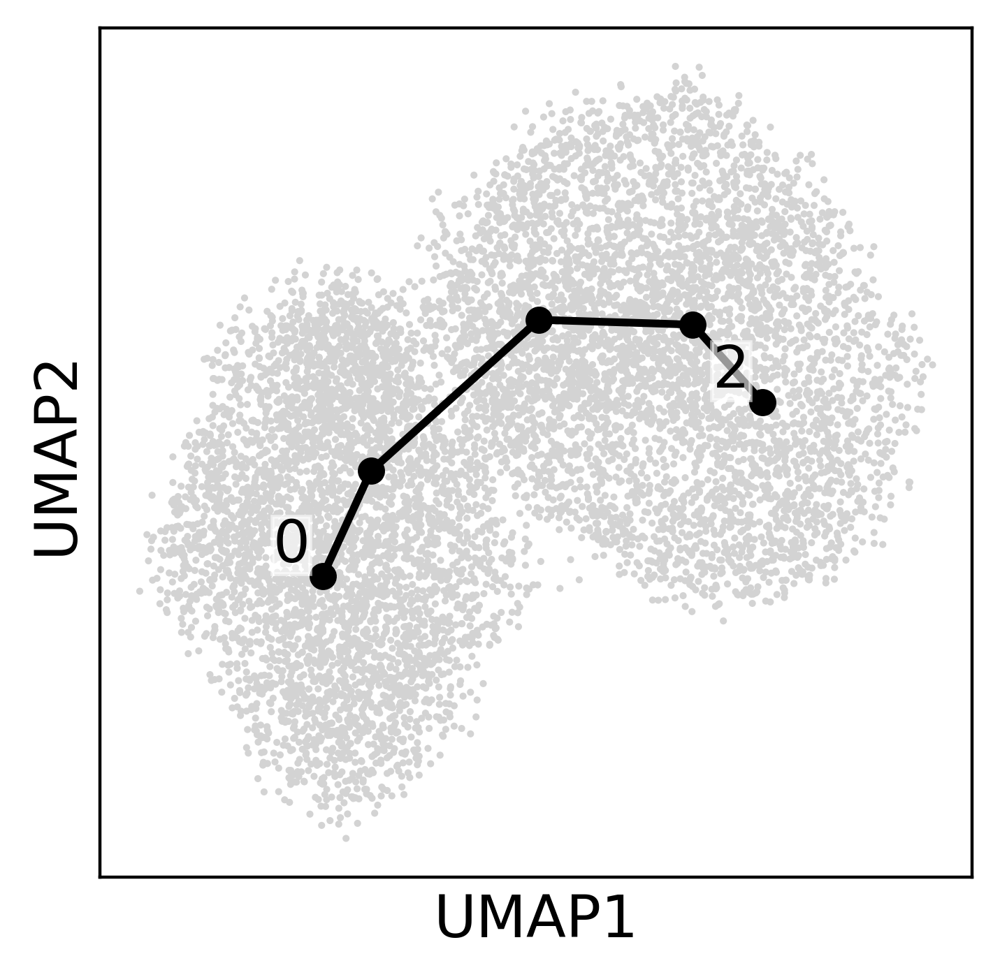

In [35]:
scf.pl.graph(adata_hvg,basis="umap")

In [36]:
scf.tl.convert_to_soft(adata_hvg,1,1000)

Converting R into soft assignment matrix
    finished (0:00:00) --> updated 
    .obsm['X_R'] converted soft assignment of cells to principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


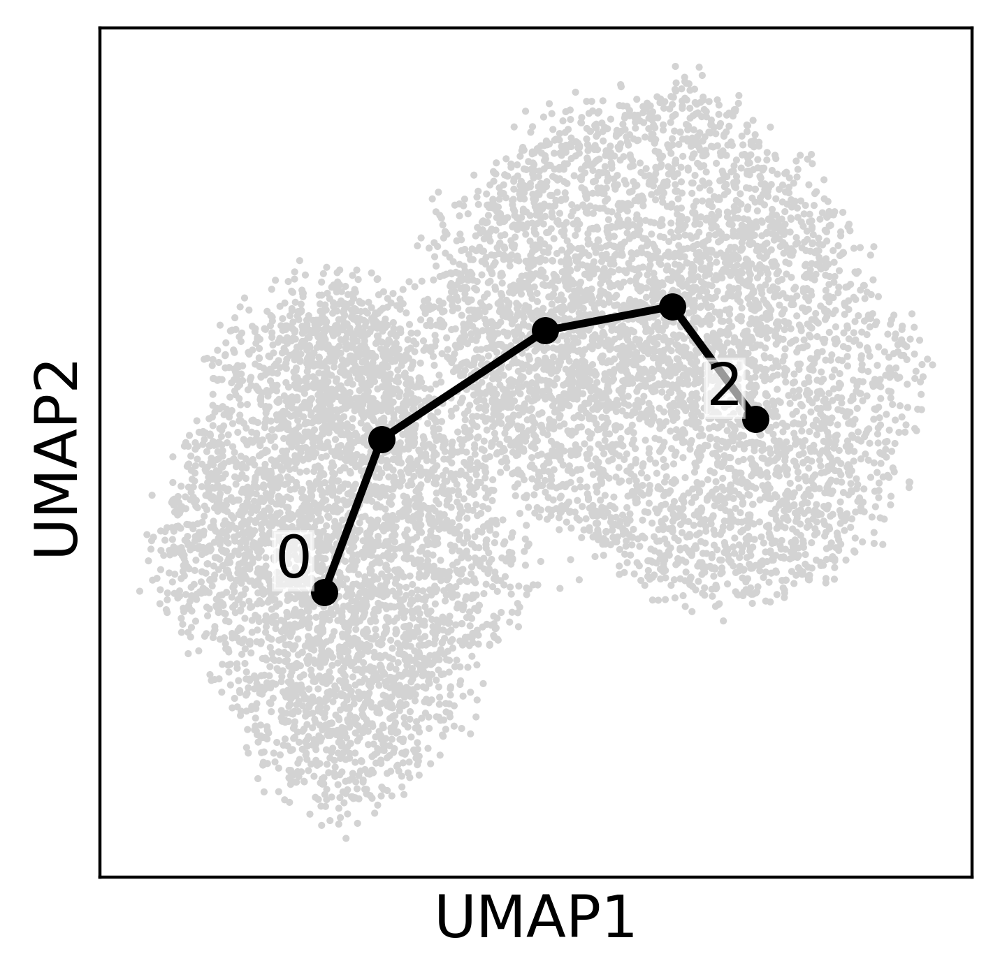

In [37]:
scf.pl.graph(adata_hvg,basis="umap")

In [38]:
scf.tl.root(adata_hvg,2)

node 2 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.


In [39]:
scf.tl.pseudotime(adata_hvg,n_jobs=20,n_map=100,seed=42)

projecting cells onto the principal graph
    mappings:   0%|          | 0/100 [00:00<?, ?it/s]

sh: which: line 1: syntax error: unexpected end of file
sh: error importing function definition for `which'
sh: module: line 1: syntax error: unexpected end of file
sh: error importing function definition for `module'
sh: scl: line 1: syntax error: unexpected end of file
sh: error importing function definition for `scl'
sh: ml: line 1: syntax error: unexpected end of file
sh: error importing function definition for `ml'
sh: which: line 1: syntax error: unexpected end of file
sh: error importing function definition for `which'
sh: module: line 1: syntax error: unexpected end of file
sh: error importing function definition for `module'
sh: scl: line 1: syntax error: unexpected end of file
sh: error importing function definition for `scl'
sh: ml: line 1: syntax error: unexpected end of file
sh: error importing function definition for `ml'
sh: which: line 1: syntax error: unexpected end of file
sh: error importing function definition for `which'
sh: module: line 1: syntax error: unexpected

    mappings: 100%|██████████| 100/100 [00:35<00:00,  2.79it/s]
    finished (0:00:39) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


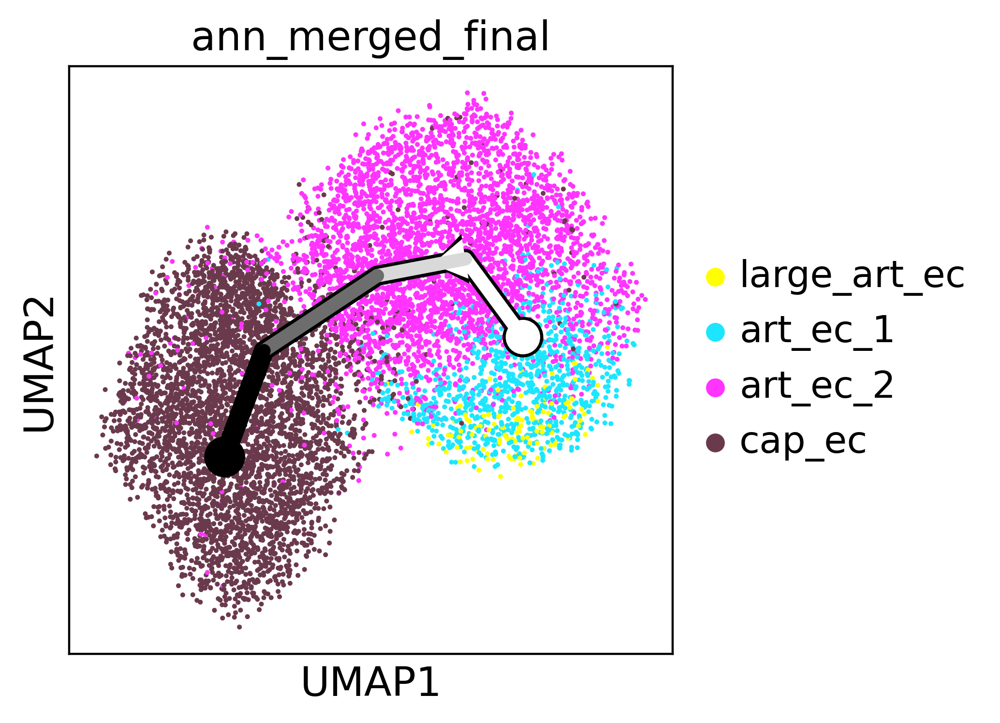

In [80]:
scf.pl.trajectory(adata_hvg,basis="umap",arrows=True,arrow_offset=1, color_cells = "ann_merged_final", cmap_seg='Greys', frameon = True)

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


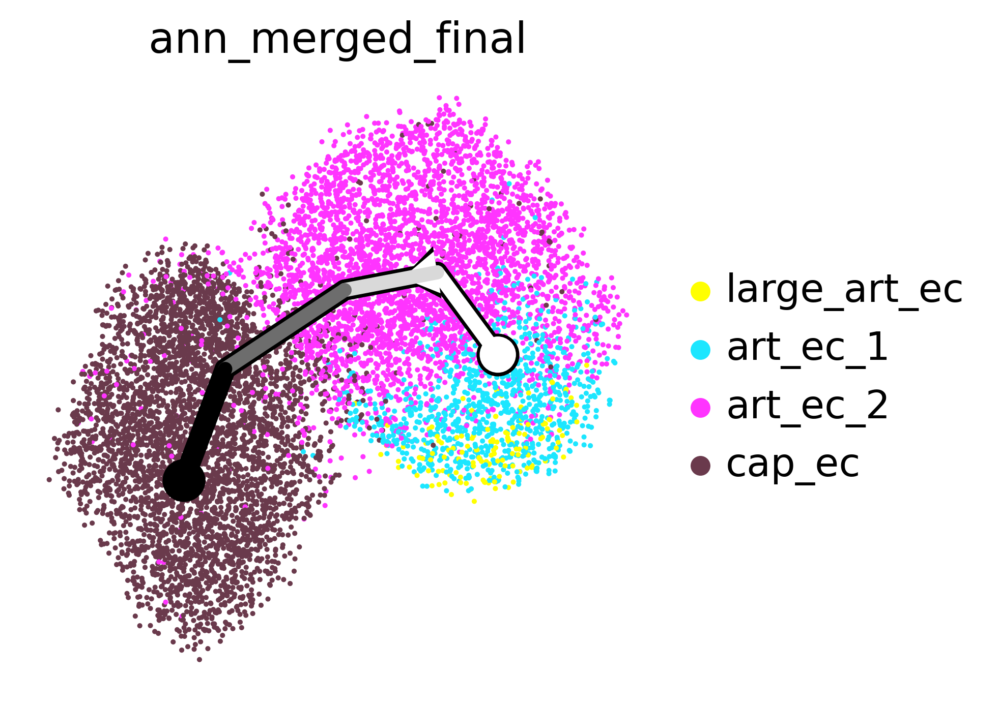

In [73]:
scf.pl.trajectory(adata_hvg,basis="umap",arrows=True,arrow_offset=1, color_cells = "ann_merged_final", cmap_seg='Greys', frameon = False)

In [ ]:
sc.pl.umap(adata_hvg, color = 'milestones')

In [ ]:
scf.tl.linearity_deviation(adata_hvg,
                           start_milestone="2",
                           end_milestone="0",
                           n_jobs=20,plot=True,basis="umap")

In [43]:
adata_hvg

AnnData object with n_obs × n_vars = 9029 × 3367
    obs: 'id', 'organ', 'donor', 'kit', 'sorting', 'location', 'age', 'gender', 'dissociation', 'scrublet_score', 'doublet_bh_pval', 'published_annotation', 'HCA', 'batch', 'study', 'sample', 'cell_ontology_class', 'free_annotation', 'compartment', 'age2', 'barcode', 'concat_sample_no', 'Population ', 'hospital_id', 'Organ', 'doublet_pval', 'Project', 'broad_celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'int_or_ext', 'leiden_scVI', 'organ_uni', 'uni_index', 'subsample', 'donor_organ', 'donor_location', 'numbering', 'ann_ec_2', 'scoring_cc_s', 'scoring_cc_m', 'scoring_cc', 'score_s_genes', 'score_g2m_genes', 'score_angio_genes', 'score_EMT_genes', 'score_MET_genes', 'score_stress_genes', 'ann_ec_av', 'ann_ec_size', 'ann_ec_cap', 'ann_ec_final', 'test', 'ann_vas_1', 'published_annotation_skin', 'int_ext', 'Cell_category', 'Predicted_labels_CellTypist', 'Majority_voti

In [ ]:
scf.tl.test_association(adata_hvg,n_jobs=20)

In [ ]:
scf.tl.test_association(adata_hvg,reapply_filters=True,A_cut=.5)
scf.pl.test_association(adata_hvg)

In [46]:
#pd.set_option('display.max_rows', None)
adata_hvg.var.signi

gene_name
FGR           False
CFH            True
SEMA3F        False
CYP51A1       False
CD99           True
              ...  
UCKL1-AS1     False
FP236383.3    False
FP671120.4    False
AL627171.2    False
PRNCR1        False
Name: signi, Length: 3367, dtype: bool

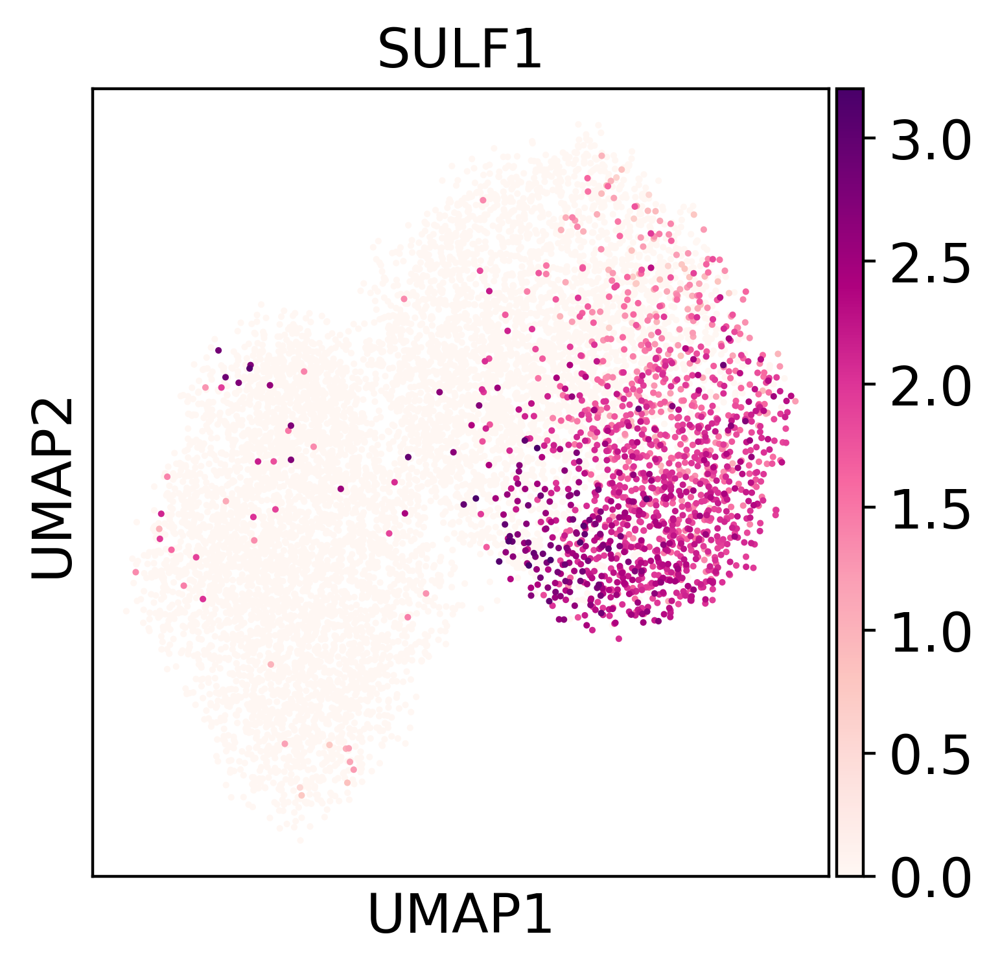

/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:55: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for name, values in obj.iteritems():
/rds/general/user/snb20/home/anaconda3/envs/scFates/lib/python3.8/site-packages/rpy2/robjects/pandas2ri.py:55: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for name, values in obj.iteritems():
sh: which: line 1: syntax error: unexpected end of file
sh: error importing function definition for `which'
sh: module: line 1: syntax error: unexpected end of file
sh: error importing function definition for `module'
sh: scl: line 1: syntax error: unexpected end of file
sh: error importing function definition for `scl'
sh: ml: line 1: syntax error: unexpected end of file
sh: error importing function definition for `ml'
sh: which: line 1: syntax error: unexpected end of file
sh: error importing 

In [74]:
sc.pl.umap(adata_hvg, color = 'SULF1', cmap = 'RdPu')

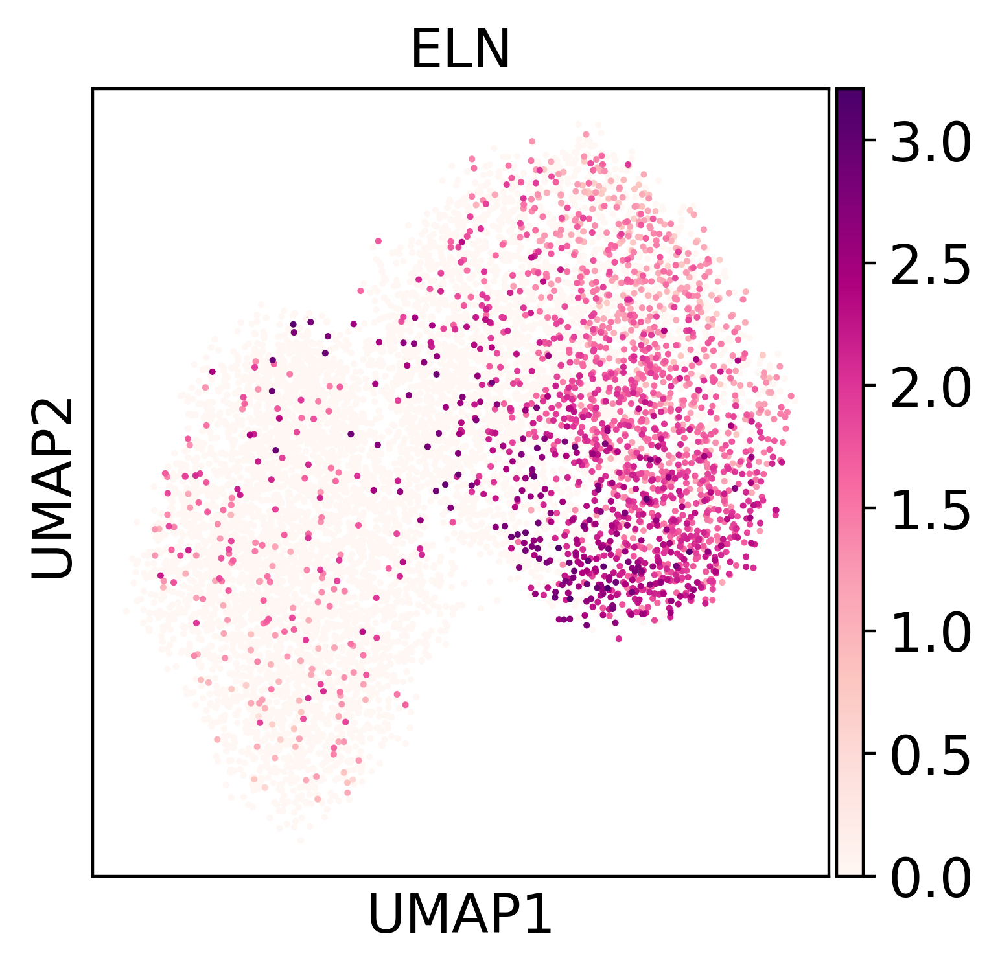

In [82]:
sc.pl.umap(adata_hvg, color = 'ELN', cmap = 'RdPu')

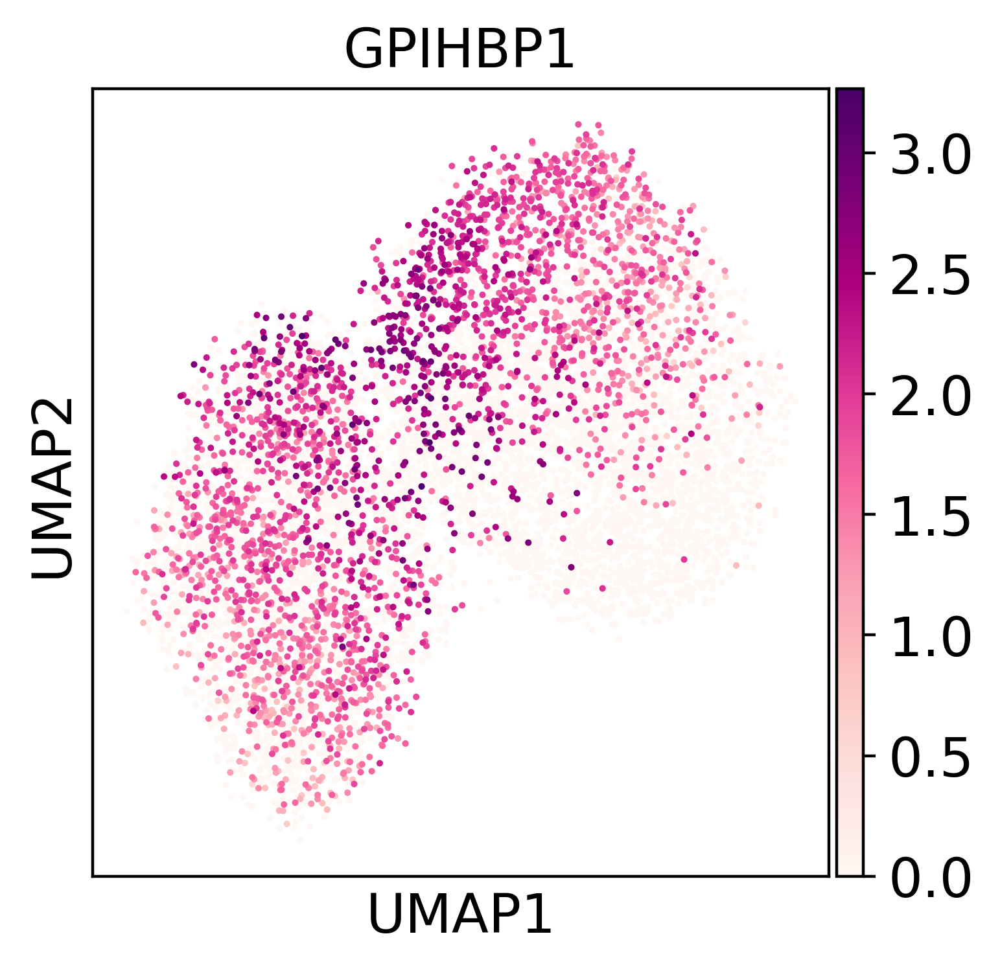

In [87]:
sc.pl.umap(adata_hvg, color = 'GPIHBP1', cmap = 'RdPu')

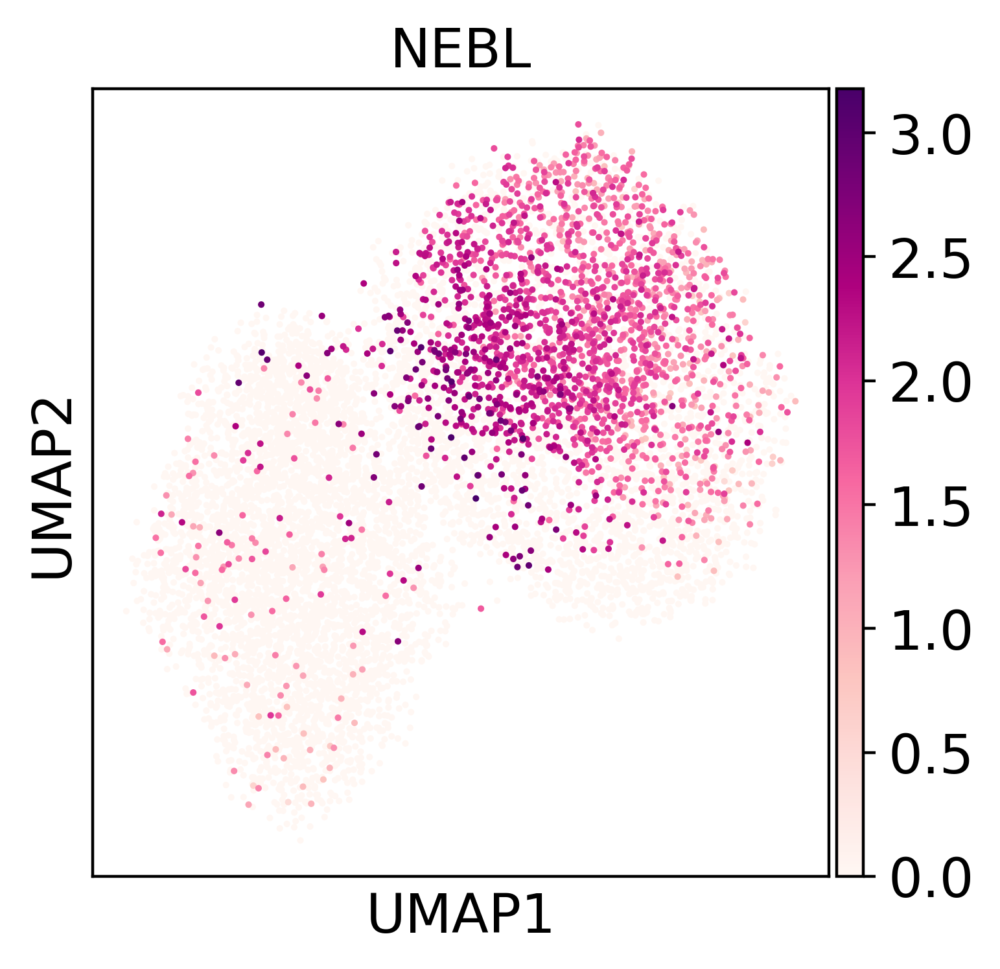

In [89]:
sc.pl.umap(adata_hvg, color = 'NEBL', cmap = 'RdPu')

sc.pl.embedding(sc.AnnData(adata_hvg.obsm["X_R"],obsm=adata_hvg.obsm), basis='X_umap', color=["0","1","2","3","4","5"],cmap="Reds")

In [ ]:
scf.tl.fit(adata_hvg,n_jobs=20)

In [49]:
adata_hvg

AnnData object with n_obs × n_vars = 9029 × 359
    obs: 'id', 'organ', 'donor', 'kit', 'sorting', 'location', 'age', 'gender', 'dissociation', 'scrublet_score', 'doublet_bh_pval', 'published_annotation', 'HCA', 'batch', 'study', 'sample', 'cell_ontology_class', 'free_annotation', 'compartment', 'age2', 'barcode', 'concat_sample_no', 'Population ', 'hospital_id', 'Organ', 'doublet_pval', 'Project', 'broad_celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'int_or_ext', 'leiden_scVI', 'organ_uni', 'uni_index', 'subsample', 'donor_organ', 'donor_location', 'numbering', 'ann_ec_2', 'scoring_cc_s', 'scoring_cc_m', 'scoring_cc', 'score_s_genes', 'score_g2m_genes', 'score_angio_genes', 'score_EMT_genes', 'score_MET_genes', 'score_stress_genes', 'ann_ec_av', 'ann_ec_size', 'ann_ec_cap', 'ann_ec_final', 'test', 'ann_vas_1', 'published_annotation_skin', 'int_ext', 'Cell_category', 'Predicted_labels_CellTypist', 'Majority_votin

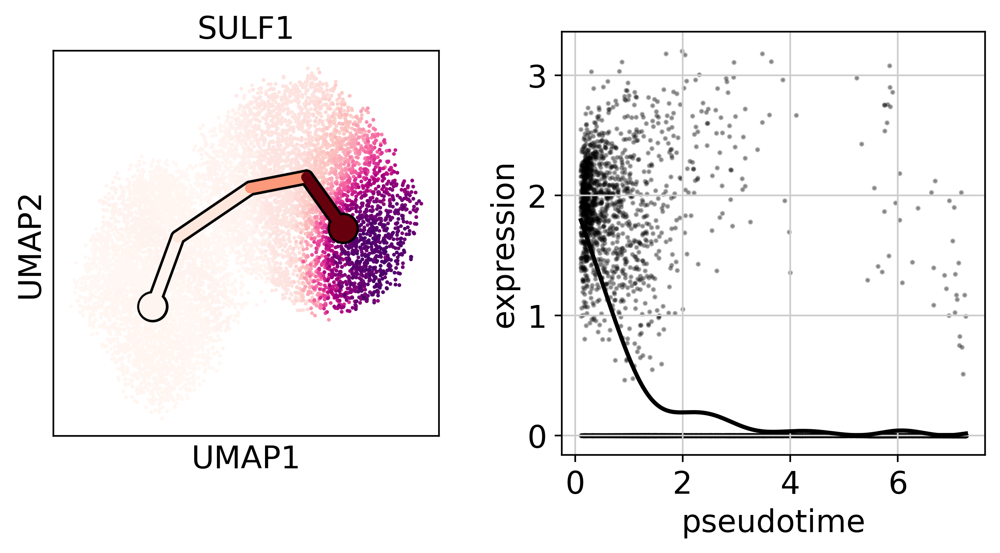

In [71]:
scf.pl.single_trend(adata_hvg,"SULF1",basis="umap",color_exp="black", cmap_cells = 'RdPu', cmap_seg='Reds')

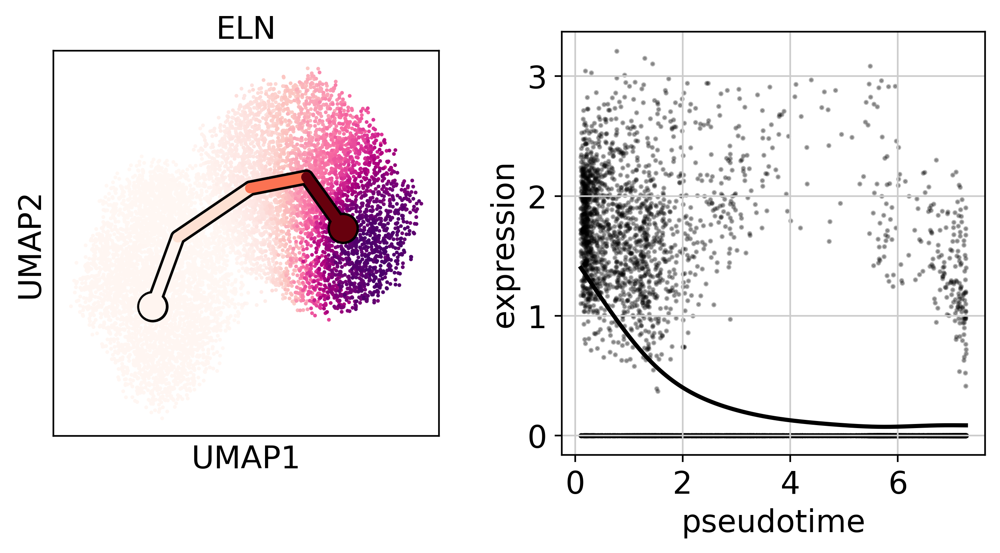

In [81]:
scf.pl.single_trend(adata_hvg,"ELN",basis="umap",color_exp="black", cmap_cells = 'RdPu', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"BGN",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"NEBL",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"ALPL",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"GPIHBP1",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"KDR",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"FABP4",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"VEGFA",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"DLL4",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"HEY1",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"LGALS3BP",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"NTRK2",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"SEMA3G",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"RGCC",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"CA4",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [ ]:
scf.pl.single_trend(adata_hvg,"FCN3",basis="umap",color_exp="black", cmap_cells = 'Reds', cmap_seg='Reds')

In [67]:
scf.tl.cluster(adata_hvg,n_neighbors=100,metric="correlation")

Clustering features using fitted layer
    finished (0:00:02) --> added 
    .var['cluters'] identified modules.


In [68]:
adata_hvg

AnnData object with n_obs × n_vars = 9029 × 359
    obs: 'id', 'organ', 'donor', 'kit', 'sorting', 'location', 'age', 'gender', 'dissociation', 'scrublet_score', 'doublet_bh_pval', 'published_annotation', 'HCA', 'batch', 'study', 'sample', 'cell_ontology_class', 'free_annotation', 'compartment', 'age2', 'barcode', 'concat_sample_no', 'Population ', 'hospital_id', 'Organ', 'doublet_pval', 'Project', 'broad_celltype', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'int_or_ext', 'leiden_scVI', 'organ_uni', 'uni_index', 'subsample', 'donor_organ', 'donor_location', 'numbering', 'ann_ec_2', 'scoring_cc_s', 'scoring_cc_m', 'scoring_cc', 'score_s_genes', 'score_g2m_genes', 'score_angio_genes', 'score_EMT_genes', 'score_MET_genes', 'score_stress_genes', 'ann_ec_av', 'ann_ec_size', 'ann_ec_cap', 'ann_ec_final', 'test', 'ann_vas_1', 'published_annotation_skin', 'int_ext', 'Cell_category', 'Predicted_labels_CellTypist', 'Majority_votin

In [69]:
adata_hvg.var.cluters.unique()

['2', '1', '0', '5', '4', '3']
Categories (6, object): ['0', '1', '2', '3', '4', '5']

In [ ]:
for c in adata_hvg.var["cluters"].unique():
    scf.pl.trends(adata_hvg,features=adata_hvg.var_names[adata_hvg.var.cluters==c],basis="umap", feature_cmap = "RdPu", pseudo_cmap = 'Greys', n_features = 20, fontsize = 6)

In [ ]:
for c in adata_hvg.var["cluters"].unique():
    scf.pl.trends(adata_hvg,features=adata_hvg.var_names[adata_hvg.var.cluters==c],basis="umap", feature_cmap = "Reds", pseudo_cmap = 'Greys', n_features = 20, fontsize = 6)

In [ ]:
for c in adata_hvg.var["cluters"].unique():
    scf.pl.trends(adata_hvg,features=adata_hvg.var_names[adata_hvg.var.cluters==c],basis="umap", feature_cmap = "Reds", pseudo_cmap = 'Greys', n_features = 15, fontsize = 8)